# Conditional Deep Convolutional Generative Adversarial Networks

Implement conditional GAN as mentioned in [Conditional Generative Adversarial Nets](https://arxiv.org/abs/1411.1784) paper.

We will use DCGAN architecture and modify for taking conditional input labels.


### Let's start by imports


In [67]:
import numpy as np
import pandas as pd
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import os
from torchsummary import summary
%matplotlib inline

In [68]:
import torch
import torchvision
import torch.nn as nn
import torch.nn.functional as F
from torchvision import datasets, transforms

In [69]:
# use cuda if available
DEVICE = torch.device("cuda" if torch.cuda.is_available()
                      else "cpu")

print(f"Using {DEVICE} backend")

BATCH_SIZE = 32 #@param {type:"integer"}

Using cuda backend


In [70]:
DEVICE

device(type='cuda')

In [71]:
!nvidia-smi

Mon Apr  3 10:25:14 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 515.65.01    Driver Version: 515.65.01    CUDA Version: 11.7     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-PCIE...  Off  | 00000000:18:00.0 Off |                    0 |
| N/A   38C    P0    37W / 250W |   8291MiB / 16384MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
|   1  Tesla V100-PCIE...  Off  | 00000000:86:00.0 Off |                    0 |
| N/A   

## Data Loading

We will use Fashion MNIST and MNIST dataset available as part of torchvision module. 

In [17]:
from torch.utils.data import Dataset, DataLoader
from PIL import Image
torch.manual_seed(0) 
class FabricDataset(Dataset):
    
    def __init__(self, data_folder, meta):
        super().__init__()
        self.df=pd.read_csv(meta, index_col=0)
        paths=self.df.name.tolist()
        # labels=[label_numeric[l] for l in self.df.label.tolist()]
        
        self.data = [(f"{data_folder}/{path}", None) for path in paths]

    def __getitem__(self, index):
        inst = self.data[index]
        return self.imge_to_tensor(inst[0])

    def __len__(self):
        return len(self.data)
    
    def imge_to_tensor(self, f):
        img = Image.open(f).convert('RGB')
        # trans_compose=transforms.ToTensor()
        transform = transforms.Compose([transforms.Resize([128, 128]),
                                        transforms.ToTensor(),
                                        transforms.Normalize([0.5], [0.5])])
        img_tensor=transform(img)
        return img_tensor

In [18]:

# label_numeric={folder:i+1 for i,folder in enumerate(os.listdir("fabrics"))}
dataset = FabricDataset("fabrics","test_urls.csv")
len(dataset)

30520

In [19]:
%%capture
# define transform to convert images to tensors and normalize
# after normalization images will be in range [-1, 1] with mean zero.
transform = transforms.Compose([transforms.ToTensor(),
                                transforms.Normalize([0.5], [0.5])
                               ])

# create generator data loader with given batch size
dataloader = torch.utils.data.DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=2, drop_last=True)

In [20]:
# for checking data, lets create iterator
# We won't use this iterator for training purpose
dataiter = iter(dataloader)
images = next(dataiter)
# MNIST image size is 1*28*28
img_size = images.shape[2]
print(images.shape)
# Create images grid of 16 rows, batch size need to be multiple of 16
# for batch size of 128, 128 images will be arranged in 8*16 grid 
torchvision.utils.save_image(images, f"FABRICS_input_grid.jpg", nrow=16, padding=0, normalize=True)

torch.Size([32, 3, 128, 128])


In [21]:
img_size

128

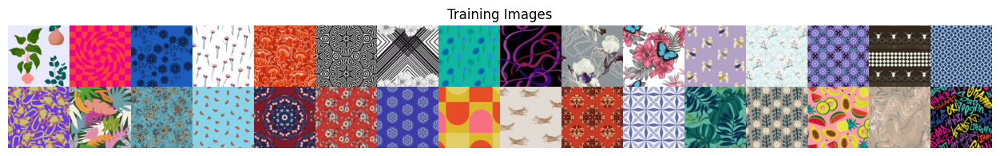

In [22]:
# Load saved training images grid and visualize using matplotlib
# Figure of size 16*(Batch_size/16)
plt.figure(figsize=(16, BATCH_SIZE/16))
plt.axis("off")
plt.title("Training Images")
# using _ for avoiding extra outputs
_ = plt.imshow(Image.open(f"FABRICS_input_grid.jpg"))

In [23]:
NUM_CLASSES=16
IMG_SIZE=128

## Discriminator Model ( D )

Discriminator is a binary classification model, which predicts if given image is generated one or taken from training data.

Discriminator model will take a image and a class label. We will reshape class label to shape (batch_size, num_labels, 28, 28) and channel corresponding to image labels will have all ones and other all zeros.

In [26]:
class Discriminator(nn.Module):
    """ D(x) """
    def __init__(self):
        # initalize super module
        super(Discriminator, self).__init__()

        # creating layer for image input
        self.layer_x = nn.Sequential(nn.Conv2d(in_channels=3, out_channels=64,
                                               kernel_size=4, stride=2, padding=1, bias=False),
                                     nn.LeakyReLU(0.2, inplace=True),
                                    )

        # creating layer for label input
        self.layer_y = nn.Sequential(nn.Conv2d(in_channels=NUM_CLASSES, out_channels=32,
                                               kernel_size=4, stride=2, padding=1, bias=False),
                                     nn.LeakyReLU(0.2, inplace=True),
                                     )

        # layer for concat of image layer and label layer, input size : (batch_size, 64, 14, 14)
        self.layer_xy = nn.Sequential(nn.Conv2d(in_channels=64, out_channels=64,
                                                kernel_size=4, stride=2, padding=1, bias=False),
                                      # nn.BatchNorm2d(64),
                                      nn.LeakyReLU(0.2, inplace=True),
                                      
                                      nn.Conv2d(in_channels=64, out_channels=128,
                                                kernel_size=4, stride=2, padding=1, bias=False),
                                      nn.BatchNorm2d(128),
                                      nn.LeakyReLU(0.2, inplace=True),

                                      nn.Conv2d(in_channels=128, out_channels=256,
                                                kernel_size=4, stride=2, padding=1, bias=False),
                                      nn.BatchNorm2d(256),
                                      nn.LeakyReLU(0.2, inplace=True),

                                      nn.Conv2d(in_channels=256, out_channels=512,
                                                kernel_size=4, stride=2, padding=1, bias=False),
                                      nn.BatchNorm2d(512),
                                      nn.LeakyReLU(0.2, inplace=True),

                                      nn.Conv2d(in_channels=512, out_channels=1,
                                                kernel_size=4, stride=2, padding=0, bias=False),
                                      # nn.BatchNorm2d(512),
                                      # nn.LeakyReLU(0.2, inplace=True),
                                       nn.Sigmoid()
                                      )


    def forward(self, x, y):
        # print("x1",x.shape)
        x = self.layer_x(x)

        # y = self.layer_y(y)

        # concat image layer and label layer output
        # xy = torch.cat([x,y], dim=1)

        xy = self.layer_xy(x)
        xy = xy.view(xy.shape[0], -1)
        return xy

In [27]:

# Create the Discriminator
netD = Discriminator()
print(netD)

Discriminator(
  (layer_x): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (layer_y): Sequential(
    (0): Conv2d(16, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (layer_xy): Sequential(
    (0): Conv2d(64, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256

In [28]:
input_data = torch.randn(2,3,128,128)
other_input_data = torch.randn(2,16, 128, 128)
summary(netD, [input_data,other_input_data])

Layer (type:depth-idx)                   Output Shape              Param #
├─Sequential: 1-1                        [-1, 64, 64, 64]          --
|    └─Conv2d: 2-1                       [-1, 64, 64, 64]          3,072
|    └─LeakyReLU: 2-2                    [-1, 64, 64, 64]          --
├─Sequential: 1-2                        [-1, 1, 1, 1]             --
|    └─Conv2d: 2-3                       [-1, 64, 32, 32]          65,536
|    └─LeakyReLU: 2-4                    [-1, 64, 32, 32]          --
|    └─Conv2d: 2-5                       [-1, 128, 16, 16]         131,072
|    └─BatchNorm2d: 2-6                  [-1, 128, 16, 16]         256
|    └─LeakyReLU: 2-7                    [-1, 128, 16, 16]         --
|    └─Conv2d: 2-8                       [-1, 256, 8, 8]           524,288
|    └─BatchNorm2d: 2-9                  [-1, 256, 8, 8]           512
|    └─LeakyReLU: 2-10                   [-1, 256, 8, 8]           --
|    └─Conv2d: 2-11                      [-1, 512, 4, 4]          

Layer (type:depth-idx)                   Output Shape              Param #
├─Sequential: 1-1                        [-1, 64, 64, 64]          --
|    └─Conv2d: 2-1                       [-1, 64, 64, 64]          3,072
|    └─LeakyReLU: 2-2                    [-1, 64, 64, 64]          --
├─Sequential: 1-2                        [-1, 1, 1, 1]             --
|    └─Conv2d: 2-3                       [-1, 64, 32, 32]          65,536
|    └─LeakyReLU: 2-4                    [-1, 64, 32, 32]          --
|    └─Conv2d: 2-5                       [-1, 128, 16, 16]         131,072
|    └─BatchNorm2d: 2-6                  [-1, 128, 16, 16]         256
|    └─LeakyReLU: 2-7                    [-1, 128, 16, 16]         --
|    └─Conv2d: 2-8                       [-1, 256, 8, 8]           524,288
|    └─BatchNorm2d: 2-9                  [-1, 256, 8, 8]           512
|    └─LeakyReLU: 2-10                   [-1, 256, 8, 8]           --
|    └─Conv2d: 2-11                      [-1, 512, 4, 4]          

## Generator Model ( G )

Aim of the generator is to fool the discriminator model. Generator will take random noise ( latent vector) z and label for which image need to be generated. Label will be passed as onehot encoding.







In [53]:
class Generator(nn.Module):
    def __init__(self, input_size=100):
        # initalize super module
        super(Generator, self).__init__()

        # noise z input layer : (batch_size, 100, 1, 1)
        self.layer_x = nn.Sequential(nn.ConvTranspose2d(in_channels=100, out_channels=512, kernel_size=4,
                                                      stride=1, padding=0, bias=False),
                                     nn.BatchNorm2d(512),
                                     nn.ReLU(),
                                    )

        # label input layer : (batch_size, 10, 1, 1)
        self.layer_y = nn.Sequential(nn.ConvTranspose2d(in_channels=NUM_CLASSES, out_channels=256, kernel_size=4,
                                                      stride=1, padding=0, bias=False),
                                     nn.BatchNorm2d(256),
                                     nn.ReLU(),
                                    )

        # noise z and label concat input layer : (batch_size, 256, 3, 3)
        self.layer_xy = nn.Sequential(
                                   nn.ConvTranspose2d(in_channels=512, out_channels=256, kernel_size=4,
                                                      stride=2, padding=1, bias=False),
                                   nn.BatchNorm2d(256),
                                   nn.ReLU(),

                                   nn.ConvTranspose2d(in_channels=256, out_channels=128, kernel_size=4,
                                                      stride=2, padding=1, bias=False),
                                   nn.BatchNorm2d(128),
                                   nn.ReLU(),

                                   nn.ConvTranspose2d(in_channels=128, out_channels=64, kernel_size=4,
                                                      stride=2, padding=1, bias=False),
                                   nn.BatchNorm2d(64),
                                   nn.ReLU(),

                                   nn.ConvTranspose2d(in_channels=64, out_channels=32, kernel_size=4,
                                                      stride=2, padding=1, bias=False),
                                   nn.BatchNorm2d(32),
                                   nn.ReLU(),
            
                                   nn.ConvTranspose2d(in_channels=32, out_channels=3, kernel_size=4,
                                                      stride=2, padding=1, bias=False),
                                   nn.Tanh())

    def forward(self, x, y):
        x = x.view(x.shape[0], x.shape[1], 1, 1)

        x = self.layer_x(x)
        # print(x.shape)

        # y = y.view(y.shape[0], y.shape[1], 1, 1)

        # y = self.layer_y(y)

        # xy = torch.cat([x,y], dim=1)
        # print(xy.shape)
        xy = self.layer_xy(x)
        return xy

In [54]:
# Create the Generator
netG = Generator()
print(netG)

Generator(
  (layer_x): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (layer_y): Sequential(
    (0): ConvTranspose2d(16, 256, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (layer_xy): Sequential(
    (0): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU()
    (6): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(64, 

In [55]:
input_data = torch.randn(2,100)
other_input_data = torch.randn(2,16)
summary(netG, [input_data,other_input_data])

Layer (type:depth-idx)                   Output Shape              Param #
├─Sequential: 1-1                        [-1, 512, 4, 4]           --
|    └─ConvTranspose2d: 2-1              [-1, 512, 4, 4]           819,200
|    └─BatchNorm2d: 2-2                  [-1, 512, 4, 4]           1,024
|    └─ReLU: 2-3                         [-1, 512, 4, 4]           --
├─Sequential: 1-2                        [-1, 3, 128, 128]         --
|    └─ConvTranspose2d: 2-4              [-1, 256, 8, 8]           2,097,152
|    └─BatchNorm2d: 2-5                  [-1, 256, 8, 8]           512
|    └─ReLU: 2-6                         [-1, 256, 8, 8]           --
|    └─ConvTranspose2d: 2-7              [-1, 128, 16, 16]         524,288
|    └─BatchNorm2d: 2-8                  [-1, 128, 16, 16]         256
|    └─ReLU: 2-9                         [-1, 128, 16, 16]         --
|    └─ConvTranspose2d: 2-10             [-1, 64, 32, 32]          131,072
|    └─BatchNorm2d: 2-11                 [-1, 64, 32, 32] 

Layer (type:depth-idx)                   Output Shape              Param #
├─Sequential: 1-1                        [-1, 512, 4, 4]           --
|    └─ConvTranspose2d: 2-1              [-1, 512, 4, 4]           819,200
|    └─BatchNorm2d: 2-2                  [-1, 512, 4, 4]           1,024
|    └─ReLU: 2-3                         [-1, 512, 4, 4]           --
├─Sequential: 1-2                        [-1, 3, 128, 128]         --
|    └─ConvTranspose2d: 2-4              [-1, 256, 8, 8]           2,097,152
|    └─BatchNorm2d: 2-5                  [-1, 256, 8, 8]           512
|    └─ReLU: 2-6                         [-1, 256, 8, 8]           --
|    └─ConvTranspose2d: 2-7              [-1, 128, 16, 16]         524,288
|    └─BatchNorm2d: 2-8                  [-1, 128, 16, 16]         256
|    └─ReLU: 2-9                         [-1, 128, 16, 16]         --
|    └─ConvTranspose2d: 2-10             [-1, 64, 32, 32]          131,072
|    └─BatchNorm2d: 2-11                 [-1, 64, 32, 32] 

## Weight Initalization 
From the DCGAN paper, the authors specify that all model weights shall be randomly initialized from a Normal distribution with mean=0, stdev=0.02.

In [56]:
# custom weights initialization
def weights_init(net):
    classname = net.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(net.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(net.weight.data, 1.0, 0.02)
        nn.init.constant_(net.bias.data, 0)

In [57]:
# randomly initialize all weights to mean=0, stdev=0.2.
netD.apply(weights_init)
netG.apply(weights_init)

Generator(
  (layer_x): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (layer_y): Sequential(
    (0): ConvTranspose2d(16, 256, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (layer_xy): Sequential(
    (0): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU()
    (6): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(64, 

## Model Training



*   Value of beta1 hyperparameter in Adam optimizer has huge impact on stability of generator and DCGAN paper recommend 0.5 value.
*   Recommended learning rate for Adam is 0.0002.

In [58]:
# number of training epochs
NUM_EPOCH = 120 #@param {type:"integer"}
# size of latent vector z
size_z = 100
# number of discriminator steps for each generator step
Ksteps = 1 #@param {type:"integer"}
# learning rate of adam
# DCGAN recommend 0.0002 lr
Adam_lr = 0.0002 #@param {type:"number"}
# DCGAN recommend 0.5
Adam_beta1 = 0.5 #@param {type:"number"}

In [59]:
# We calculate Binary cross entropy loss
criterion = nn.BCELoss()
# Adam optimizer for generator 
optimizerG = torch.optim.Adam(netG.parameters(), lr=Adam_lr, betas=(Adam_beta1, 0.999))
# Adam optimizer for discriminator 
optimizerD = torch.optim.Adam(netD.parameters(), lr=Adam_lr, betas=(Adam_beta1, 0.999))

In [60]:
# labels for training images x for Discriminator training
labels_real = torch.ones((BATCH_SIZE, 1)).to(DEVICE)
# labels for generated images G(z) for Discriminator training
labels_fake = torch.zeros((BATCH_SIZE, 1)).to(DEVICE)
# Fix noise for testing generator and visualization
z_test = torch.randn(100, size_z).to(DEVICE)

In [61]:
# convert labels to onehot encoding
onehot = torch.zeros(NUM_CLASSES, NUM_CLASSES).scatter_(1, torch.tensor(list(range(NUM_CLASSES))).view(NUM_CLASSES,1), 1)
# reshape labels to image size, with number of labels as channel
fill = torch.zeros([NUM_CLASSES, NUM_CLASSES, img_size, img_size])
#channel corresponding to label will be set one and all other zeros
for i in range(NUM_CLASSES):
    fill[i, i, :, :] = 1
# create labels for testing generator
test_y = torch.tensor(list(range(NUM_CLASSES))*10).type(torch.LongTensor)[:100]
# convert to one hot encoding
test_Gy = onehot[test_y].to(DEVICE)

In [62]:
test_y.shape

torch.Size([100])

In [63]:
test_Gy.shape

torch.Size([100, 16])

In [64]:
from tqdm import tqdm

In [65]:
# List of values, which will be used for plotting purpose
D_losses = []
D_x_losses = []
D_z_losses = []

G_losses = []
Dx_values = []
DGz_values = []

In [66]:
y_labels=[1]*BATCH_SIZE

# number of training steps done on discriminator 
step = 0
for epoch in tqdm(range(NUM_EPOCH)):
  epoch_D_losses = []
  epoch_D_x_losses=[]
  epoch_D_z_losses=[]
  epoch_G_losses = []
  epoch_Dx = []
  epoch_DGz = []
  # iterate through data loader generator object
  for images in dataloader:
    step += 1
    ############################
    # Update D network: maximize log(D(x)) + log(1 - D(G(z)))
    ###########################
    # images will be send to gpu, if cuda available
    x = images.to(DEVICE)
    # print("x",x.shape)
    # preprocess labels for feeding as y input
    # D_y shape will be (batch_size, 10, 28, 28)
    D_y = fill[y_labels].to(DEVICE)
    
    # forward pass D(x)
    
    x_preds = netD(x, D_y)
    
    # calculate loss log(D(x))
    D_x_loss = criterion(x_preds, labels_real)
    
    # create latent vector z from normal distribution 
    z = torch.randn(BATCH_SIZE, size_z).to(DEVICE)
    
    # create random y labels for generator
    y_gen = (torch.rand(BATCH_SIZE, 1)*NUM_CLASSES).type(torch.LongTensor).squeeze()
    
    # convert genarator labels to onehot
    G_y = onehot[y_gen].to(DEVICE)
    
    # preprocess labels for feeding as y input in D
    # DG_y shape will be (batch_size, 10, 28, 28)
    DG_y = fill[y_gen].to(DEVICE)
    
    # generate image
    fake_image = netG(z, G_y)
    
    # calculate D(G(z)), fake or not
    z_preds = netD(fake_image.detach(), DG_y)
    # loss log(1 - D(G(z)))
    D_z_loss = criterion(z_preds, labels_fake)
    
    # total loss = log(D(x)) + log(1 - D(G(z)))
    D_loss = D_x_loss + D_z_loss
    
    # save values for plots
    epoch_D_x_losses.append(D_x_loss.item())
    
    epoch_D_z_losses.append(D_z_loss.item())
    
    epoch_D_losses.append(D_loss.item())
    epoch_Dx.append(x_preds.mean().item())
    
    # zero accumalted grads
    netD.zero_grad()
    # do backward pass
    D_loss.backward()
    # update discriminator model
    optimizerD.step()
    
    ############################
    # Update G network: maximize log(D(G(z)))
    ###########################
        
    # if Ksteps of Discriminator training are done, update generator
    if step % Ksteps == 0:
      # As we done one step of discriminator, again calculate D(G(z))
      z_out = netD(fake_image, DG_y)
      # loss log(D(G(z)))
      G_loss = criterion(z_out, labels_real)
      # save values for plots
      epoch_DGz.append(z_out.mean().item())
      epoch_G_losses.append(G_loss)
      
      # zero accumalted grads
      netG.zero_grad()
      # do backward pass
      G_loss.backward()
      # update generator model
      optimizerG.step()
  else:
    # calculate average value for one epoch
    D_losses.append(sum(epoch_D_losses)/len(epoch_D_losses))
    D_z_losses.append(sum(epoch_D_z_losses)/len(epoch_D_z_losses))
    D_x_losses.append(sum(epoch_D_x_losses)/len(epoch_D_x_losses))
    G_losses.append(sum(epoch_G_losses)/len(epoch_G_losses))
    Dx_values.append(sum(epoch_Dx)/len(epoch_Dx))
    DGz_values.append(sum(epoch_DGz)/len(epoch_DGz))
    
    print(f" Epoch {epoch+1}/{NUM_EPOCH} Discriminator Loss {D_losses[-1]:.3f} Generator Loss {G_losses[-1]:.3f}"
         + f" D(x) {Dx_values[-1]:.3f} D(G(x)) {DGz_values[-1]:.3f}")
    
    # Generating images after each epoch and saving
    # set generator to evaluation mode
    netG.eval()
    with torch.no_grad():
      # forward pass of G and generated image
      fake_test = netG(z_test, test_Gy).cpu()
      # save images in grid of 10 * 10
      torchvision.utils.save_image(fake_test, f"exp3_DCGAN_all/FABRICS_epoch_{epoch+1}.jpg", nrow=10, padding=0, normalize=True)
    # set generator to training mode
    netG.train()

  0%|                                                   | 0/120 [01:25<?, ?it/s]


UnidentifiedImageError: Caught UnidentifiedImageError in DataLoader worker process 1.
Original Traceback (most recent call last):
  File "/bi/home/pmehrbod/.conda/envs/GAN/lib/python3.8/site-packages/torch/utils/data/_utils/worker.py", line 302, in _worker_loop
    data = fetcher.fetch(index)
  File "/bi/home/pmehrbod/.conda/envs/GAN/lib/python3.8/site-packages/torch/utils/data/_utils/fetch.py", line 58, in fetch
    data = [self.dataset[idx] for idx in possibly_batched_index]
  File "/bi/home/pmehrbod/.conda/envs/GAN/lib/python3.8/site-packages/torch/utils/data/_utils/fetch.py", line 58, in <listcomp>
    data = [self.dataset[idx] for idx in possibly_batched_index]
  File "/tmp/ipykernel_15624/2391473551.py", line 16, in __getitem__
    return self.imge_to_tensor(inst[0])
  File "/tmp/ipykernel_15624/2391473551.py", line 22, in imge_to_tensor
    img = Image.open(f).convert('RGB')
  File "/bi/home/pmehrbod/.conda/envs/GAN/lib/python3.8/site-packages/PIL/Image.py", line 3283, in open
    raise UnidentifiedImageError(msg)
PIL.UnidentifiedImageError: cannot identify image file 'fabrics/845152375-wild-flowers.jpg'


## Results

After 20 epoch training, we are able to generate quite good images.

FileNotFoundError: [Errno 2] No such file or directory: 'FABRICS_epoch_120.jpg'

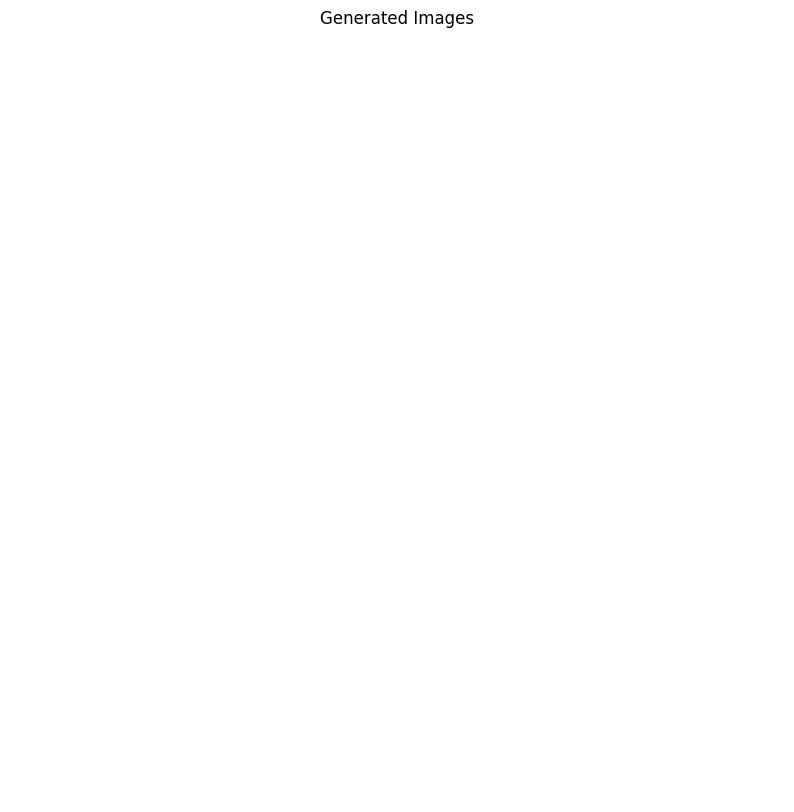

In [82]:
# Load saved generated images grid and visualize using matplotlib
# Figure of size 10*10
plt.figure(figsize=(10, 10))
plt.axis("off")
plt.title("Generated Images")
# using _ for avoiding extra outputs
_ = plt.imshow(Image.open(f"FABRICS_epoch_{NUM_EPOCH}.jpg"))

### Animation of generated images after each epoch

In [ ]:
%%capture
# using capture magic for avoiding extra outputs
fig = plt.figure(figsize=(10,10))
plt.axis("off")
# load all images
ims = [[plt.imshow(Image.open(f"FABRICS_epoch_{i+1}.jpg"), animated=True)] for i in range(80)]
# create animation 
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

In [ ]:
matplotlib.rcParams['animation.embed_limit'] = 2**128

NameError: name 'matplotlib' is not defined

In [ ]:
# showing animation using Ipython HTML
HTML(ani.to_jshtml())

Animation size has reached 22175751 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [ ]:
ani.save('FMNIST_animation.gif', writer='imagemagick', fps=5)



### Plot for Discriminator and Generator loss over the epochs

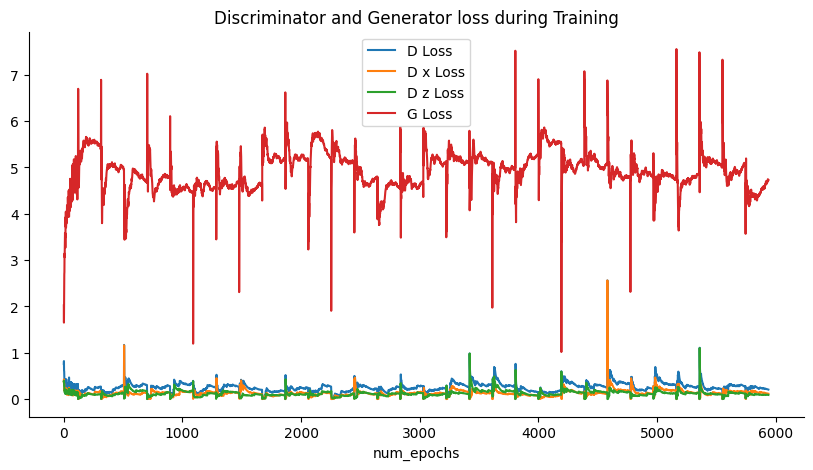

In [89]:
plt.figure(figsize=(10,5))
plt.title("Discriminator and Generator loss during Training")
# plot Discriminator and generator loss
plt.plot(D_losses,label="D Loss")
plt.plot([g.detach().cpu() for g in G_losses],label="G Loss")
# get plot axis
ax = plt.gca()
# remove right and top spine
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
# add labels and create legend
plt.xlabel("num_epochs")
plt.legend()
plt.show()